# Proyek Analisis Data: [Input Nama Dataset]
- **Nama:** PUTRI SUGIARTI ALWIYANSYA RANI 
- **Email:** putrirani57618@gmail.com
- **ID Dicoding:** M395B4KX3525

## Menentukan Pertanyaan Bisnis

- Bagaimana pengaruh keterlambatan pengiriman (delayed delivery) terhadap kepuasan pelanggan berdasarkan skor ulasan?
- Apakah terdapat perbedaan dalam nilai review berdasarkan status pesanan dan jenis pembayaran yang digunakan?

## Import Semua Packages/Library yang Digunakan

In [1]:
import pandas as pd
import plotly.express as px
import plotly.graph_objects as go
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

## Data Wrangling

### Gathering Data

In [2]:
# Baca dataset
customers = pd.read_csv('data/customers_dataset.csv')
geolocation = pd.read_csv('data/geolocation_dataset.csv')
order_items = pd.read_csv('data/order_items_dataset.csv')
order_payments = pd.read_csv('data/order_payments_dataset.csv')
order_reviews = pd.read_csv('data/order_reviews_dataset.csv')
orders = pd.read_csv('data/orders_dataset.csv')
products = pd.read_csv('data/products_dataset.csv')
product_category_translation = pd.read_csv('data/product_category_name_translation.csv')
sellers = pd.read_csv('data/sellers_dataset.csv')

### Assessing Data

In [3]:
# Identifikasi dan hitung jumlah duplikasi pada setiap dataset

print("Duplikasi pada dataset orders:")
duplicate_orders = orders[orders.duplicated(keep=False)]
print(f"Jumlah baris duplikat: {duplicate_orders.shape[0]}")

print("\nDuplikasi pada dataset customers:")
duplicate_customers = customers[customers.duplicated(keep=False)]
print(f"Jumlah baris duplikat: {duplicate_customers.shape[0]}")

print("\nDuplikasi pada dataset geolocation:")
duplicate_geolocation = geolocation[geolocation.duplicated(keep=False)]
print(f"Jumlah baris duplikat: {duplicate_geolocation.shape[0]}")

print("\nDuplikasi pada dataset products:")
duplicate_products = products[products.duplicated(keep=False)]
print(f"Jumlah baris duplikat: {duplicate_products.shape[0]}")

print("\nDuplikasi pada dataset product_category_translation:")
duplicate_product_category_translation = product_category_translation[product_category_translation.duplicated(keep=False)]
print(f"Jumlah baris duplikat: {duplicate_product_category_translation.shape[0]}")

print("\nDuplikasi pada dataset order_items:")
duplicate_order_items = order_items[order_items.duplicated(keep=False)]
print(f"Jumlah baris duplikat: {duplicate_order_items.shape[0]}")

print("\nDuplikasi pada dataset order_payments:")
duplicate_order_payments = order_payments[order_payments.duplicated(keep=False)]
print(f"Jumlah baris duplikat: {duplicate_order_payments.shape[0]}")

print("\nDuplikasi pada dataset order_reviews:")
duplicate_order_reviews = order_reviews[order_reviews.duplicated(keep=False)]
print(f"Jumlah baris duplikat: {duplicate_order_reviews.shape[0]}")

print("\nDuplikasi pada dataset sellers:")
duplicate_sellers = sellers[sellers.duplicated(keep=False)]
print(f"Jumlah baris duplikat: {duplicate_sellers.shape[0]}")

Duplikasi pada dataset orders:
Jumlah baris duplikat: 0

Duplikasi pada dataset customers:
Jumlah baris duplikat: 0

Duplikasi pada dataset geolocation:
Jumlah baris duplikat: 390005

Duplikasi pada dataset products:
Jumlah baris duplikat: 0

Duplikasi pada dataset product_category_translation:
Jumlah baris duplikat: 0

Duplikasi pada dataset order_items:
Jumlah baris duplikat: 0

Duplikasi pada dataset order_payments:
Jumlah baris duplikat: 0

Duplikasi pada dataset order_reviews:
Jumlah baris duplikat: 0

Duplikasi pada dataset sellers:
Jumlah baris duplikat: 0


### Cleaning Data

#### 1. Membulatkan latitude dan longitude

In [4]:
geolocation['geolocation_lat'] = geolocation['geolocation_lat'].round(4)
geolocation['geolocation_lng'] = geolocation['geolocation_lng'].round(4)

#### 2. Menggabungkan dataset, menghapus kolom tidak perlu dan menghapus duplikasi berdasarkan 'order_id'

In [5]:
# Menggabungkan dataset
orders_customers = pd.merge(orders, customers, on='customer_id', how='left')
customers_geo = pd.merge(customers, geolocation, left_on='customer_zip_code_prefix', right_on='geolocation_zip_code_prefix', how='left')
order_items_products = pd.merge(order_items, products, on='product_id', how='left')
order_items_products = pd.merge(order_items_products, product_category_translation, on='product_category_name', how='left')
orders_payments = pd.merge(orders, order_payments, on='order_id', how='left')
orders_reviews = pd.merge(order_reviews, orders, on='order_id', how='left')
order_items_sellers = pd.merge(order_items_products, sellers, on='seller_id', how='left')

# Menggabungkan semua dataset ke final_dataset
final_dataset = pd.merge(order_items_sellers, orders_customers, on='order_id', how='left')
final_dataset = pd.merge(final_dataset, orders_payments, on='order_id', how='left')
final_dataset = pd.merge(final_dataset, orders_reviews, on='order_id', how='left')
final_dataset = pd.merge(final_dataset, customers_geo, on='customer_id', how='left')

# Menghapus kolom yang tidak perlu
final_dataset = final_dataset.drop(columns=['customer_zip_code_prefix_x', 'customer_zip_code_prefix_y', 'geolocation_zip_code_prefix'])

# Menghapus duplikasi berdasarkan 'order_id'
final_dataset = final_dataset.drop_duplicates(subset='order_id')

#### 3. Memperbaiki tipe data

In [6]:
final_dataset.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 98666 entries, 0 to 17923171
Data columns (total 60 columns):
 #   Column                           Non-Null Count  Dtype  
---  ------                           --------------  -----  
 0   order_id                         98666 non-null  object 
 1   order_item_id                    98666 non-null  int64  
 2   product_id                       98666 non-null  object 
 3   seller_id                        98666 non-null  object 
 4   shipping_limit_date              98666 non-null  object 
 5   price                            98666 non-null  float64
 6   freight_value                    98666 non-null  float64
 7   product_category_name            97250 non-null  object 
 8   product_name_lenght              97250 non-null  float64
 9   product_description_lenght       97250 non-null  float64
 10  product_photos_qty               97250 non-null  float64
 11  product_weight_g                 98650 non-null  float64
 12  product_length_

In [7]:
# Mengonversi kolom yang memiliki tipe data yang tidak sesuai
final_dataset['order_id'] = final_dataset['order_id'].astype(str)
final_dataset['product_id'] = final_dataset['product_id'].astype(str)
final_dataset['seller_id'] = final_dataset['seller_id'].astype(str)
final_dataset['shipping_limit_date'] = pd.to_datetime(final_dataset['shipping_limit_date'])
final_dataset['customer_id_x'] = final_dataset['customer_id_x'].astype(str)
final_dataset['customer_id_y'] = final_dataset['customer_id_y'].astype(str)
final_dataset['customer_unique_id_x'] = final_dataset['customer_unique_id_x'].astype(str)
final_dataset['customer_unique_id_y'] = final_dataset['customer_unique_id_y'].astype(str)

# Mengonversi kolom waktu ke datetime
datetime_columns = [
    'order_purchase_timestamp_x', 'order_approved_at_x', 
    'order_delivered_carrier_date_x', 'order_delivered_customer_date_x', 
    'order_estimated_delivery_date_x', 'order_purchase_timestamp_y', 
    'order_approved_at_y', 'order_delivered_carrier_date_y', 
    'order_delivered_customer_date_y', 'order_estimated_delivery_date_y', 
    'review_creation_date', 'review_answer_timestamp', 
    'order_purchase_timestamp', 'order_approved_at', 
    'order_delivered_carrier_date', 'order_delivered_customer_date', 
    'order_estimated_delivery_date'
]

for col in datetime_columns:
    final_dataset[col] = pd.to_datetime(final_dataset[col], errors='coerce')

# Mengonversi kolom jumlah ke integer
final_dataset['product_photos_qty'] = final_dataset['product_photos_qty'].astype('Int64')  # 'Int64' untuk mengatasi nilai NaN
final_dataset['payment_sequential'] = final_dataset['payment_sequential'].astype('Int64')
final_dataset['payment_installments'] = final_dataset['payment_installments'].astype('Int64')
final_dataset['review_score'] = final_dataset['review_score'].astype('Int64')

#### 4. Missing Value

In [8]:
final_dataset.isna().sum()

order_id                               0
order_item_id                          0
product_id                             0
seller_id                              0
shipping_limit_date                    0
price                                  0
freight_value                          0
product_category_name               1416
product_name_lenght                 1416
product_description_lenght          1416
product_photos_qty                  1416
product_weight_g                      16
product_length_cm                     16
product_height_cm                     16
product_width_cm                      16
product_category_name_english       1437
seller_zip_code_prefix                 0
seller_city                            0
seller_state                           0
customer_id_x                          0
order_status_x                         0
order_purchase_timestamp_x             0
order_approved_at_x                   14
order_delivered_carrier_date_x      1009
order_delivered_

## Exploratory Data Analysis (EDA)

### Explore ...

In [9]:
# Inisialisasi list untuk menyimpan nama kolom
numerical_cols = []  
categorical_cols = []  
date_cols = [] 

# Iterasi melalui kolom DataFrame dan mengategorikannya
for col in final_dataset.columns:
    if pd.api.types.is_numeric_dtype(final_dataset[col]):
        numerical_cols.append(col) 
    elif pd.api.types.is_datetime64_any_dtype(final_dataset[col]):
        date_cols.append(col)  
    else:
        categorical_cols.append(col)  #

# Menampilkan hasil kategori kolom
print("Kolom Numerik:")
print(numerical_cols)
print("\nKolom Kategorikal:")
print(categorical_cols)
print("\nKolom Tanggal:")
print(date_cols)

Kolom Numerik:
['order_item_id', 'price', 'freight_value', 'product_name_lenght', 'product_description_lenght', 'product_photos_qty', 'product_weight_g', 'product_length_cm', 'product_height_cm', 'product_width_cm', 'seller_zip_code_prefix', 'payment_sequential', 'payment_installments', 'payment_value', 'review_score', 'geolocation_lat', 'geolocation_lng']

Kolom Kategorikal:
['order_id', 'product_id', 'seller_id', 'product_category_name', 'product_category_name_english', 'seller_city', 'seller_state', 'customer_id_x', 'order_status_x', 'customer_unique_id_x', 'customer_city_x', 'customer_state_x', 'customer_id_y', 'order_status_y', 'payment_type', 'review_id', 'review_comment_title', 'review_comment_message', 'customer_id', 'order_status', 'customer_unique_id_y', 'customer_city_y', 'customer_state_y', 'geolocation_city', 'geolocation_state']

Kolom Tanggal:
['shipping_limit_date', 'order_purchase_timestamp_x', 'order_approved_at_x', 'order_delivered_carrier_date_x', 'order_delivered_c

<Axes: >

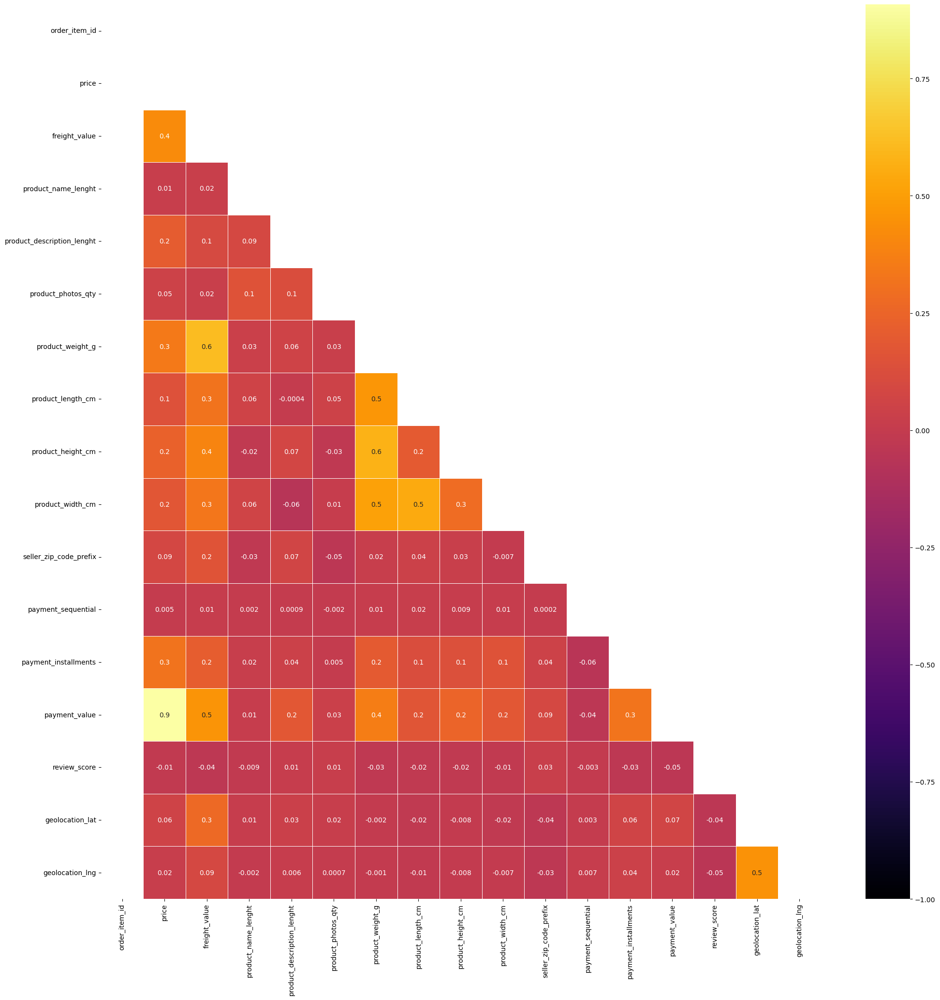

In [10]:
# Visualisasi Korelasi Matriks
mask = np.zeros_like(final_dataset.corr().fillna(0), dtype=np.bool_)
mask[np.triu_indices_from(mask)] = True
plt.figure(figsize=(24,24))
sns.heatmap(final_dataset.corr(), mask=mask, annot=True,  cmap="inferno", vmin = -1, fmt='.1g', edgecolor='w', linewidth=0.6)

In [11]:
# 1. Summary Statistics: Total Orders dan Total Revenue
total_orders = final_dataset['order_id'].nunique()
total_revenue = final_dataset['price'].sum()

fig_summary = go.Figure()

fig_summary.add_trace(go.Indicator(
    mode="number",
    value=total_orders,
    title={"text": "Total Orders"},
    domain={'row': 0, 'column': 0}))

fig_summary.add_trace(go.Indicator(
    mode="number",
    value=total_revenue,
    title={"text": "Total Revenue ($)"},
    domain={'row': 0, 'column': 1}))

fig_summary.update_layout(
    grid={'rows': 1, 'columns': 2, 'pattern': "independent"},
    title="Summary Statistics")

fig_summary.show()

In [12]:
# Distribusi Kategori Produk
fig1 = px.bar(final_dataset['product_category_name'].value_counts().head(10), 
            x=final_dataset['product_category_name'].value_counts().head(10).index,
            y=final_dataset['product_category_name'].value_counts().head(10).values,
            title='Distribusi Kategori Produk Teratas',
            labels={'x': 'Kategori Produk', 'y': 'Frekuensi'})

fig1.show()

In [13]:
# Distribusi Status Pesanan
fig2 = px.bar(final_dataset['order_status_x'].value_counts(), 
            x=final_dataset['order_status_x'].value_counts().index,
            y=final_dataset['order_status_x'].value_counts().values,
            title='Distribusi Status Pesanan',
            labels={'x': 'Status Pesanan', 'y': 'Frekuensi'})

fig2.show()

In [14]:
# Distribusi tipe pembayaran
fig3 = px.bar(final_dataset['payment_type'].value_counts(), 
            x=final_dataset['payment_type'].value_counts().index,
            y=final_dataset['payment_type'].value_counts().values,
            title='Distribusi Tipe Pembayaran',
            labels={'x': 'Tipe Pembayaran', 'y': 'Frekuensi'})

fig3.show()

In [15]:
# Distribusi status ulasan
fig4 = px.bar(final_dataset['review_score'].value_counts(), 
            x=final_dataset['review_score'].value_counts().index,
            y=final_dataset['review_score'].value_counts().values,
            title='Distribusi Skor Ulasan',
            labels={'x': 'Skor Ulasan', 'y': 'Frekuensi'})

fig4.show()

In [16]:
# Distribusi kota penjual
fig5 = px.bar(final_dataset['seller_city'].value_counts().head(10), 
            x=final_dataset['seller_city'].value_counts().head(10).index,
            y=final_dataset['seller_city'].value_counts().head(10).values,
            title='Distribusi Kota Penjual Teratas',
            labels={'x': 'Kota Penjual', 'y': 'Frekuensi'})

fig5.show()

In [17]:
# Distribusi kota pelanggan
fig6 = px.bar(final_dataset['customer_city_x'].value_counts().head(10), 
            x=final_dataset['customer_city_x'].value_counts().head(10).index,
            y=final_dataset['customer_city_x'].value_counts().head(10).values,
            title='Distribusi Kota Pelanggan Teratas',
            labels={'x': 'Kota Pelanggan', 'y': 'Frekuensi'})

fig6.show()

In [18]:
# Distribusi kategori produk
fig10 = px.bar(final_dataset['product_category_name_english'].value_counts().head(10), 
                x=final_dataset['product_category_name_english'].value_counts().head(10).index,
                y=final_dataset['product_category_name_english'].value_counts().head(10).values,
                title='Distribusi Kategori Produk',
                labels={'x': 'Kategori Produk (EN)', 'y': 'Frekuensi'})

fig10.show()

#### Distribusi Datetime

In [19]:
# Distribusi Waktu Pembelian Pesanan
final_dataset['order_purchase_timestamp'] = pd.to_datetime(final_dataset['order_purchase_timestamp'])
final_dataset['order_purchase_hour'] = final_dataset['order_purchase_timestamp'].dt.hour

fig1 = px.histogram(final_dataset, x='order_purchase_hour', nbins=24,
                    title='Distribusi Waktu Pembelian Pesanan',
                    labels={'order_purchase_hour': 'Jam', 'count': 'Jumlah Pesanan'})
fig1.show()

In [20]:
# Distribusi Durasi Pengiriman
final_dataset['order_delivered_customer_date'] = pd.to_datetime(final_dataset['order_delivered_customer_date'])
final_dataset['shipping_time'] = (final_dataset['order_delivered_customer_date'] - final_dataset['order_delivered_carrier_date']).dt.days

fig3 = px.histogram(final_dataset, x='shipping_time', nbins=30,
                    title='Distribusi Durasi Pengiriman',
                    labels={'shipping_time': 'Durasi Pengiriman (Hari)', 'count': 'Jumlah Pesanan'})
fig3.show()

In [21]:
# Perbandingan Estimasi dan Realisasi Pengiriman
final_dataset['order_estimated_delivery_date'] = pd.to_datetime(final_dataset['order_estimated_delivery_date'])
final_dataset['delivery_delay'] = (final_dataset['order_delivered_customer_date'] - final_dataset['order_estimated_delivery_date']).dt.days

fig4 = px.histogram(final_dataset, x='delivery_delay', nbins=30,
                    title='Perbandingan Estimasi dan Realisasi Pengiriman',
                    labels={'delivery_delay': 'Keterlambatan (Hari)', 'count': 'Jumlah Pesanan'})
fig4.show()

In [22]:
# Daily Revenue vs Orders
daily_revenue = final_dataset.groupby(final_dataset['order_purchase_timestamp'].dt.date).agg({'price': 'sum', 'order_id': 'nunique'}).reset_index()
daily_revenue.columns = ['Date', 'Total Revenue', 'Total Orders']

fig_revenue_orders = go.Figure()

fig_revenue_orders.add_trace(go.Scatter(
    x=daily_revenue['Date'], 
    y=daily_revenue['Total Revenue'], 
    mode='lines', 
    name='Total Revenue',
    yaxis='y1'
))

fig_revenue_orders.add_trace(go.Bar(
    x=daily_revenue['Date'], 
    y=daily_revenue['Total Orders'], 
    name='Total Orders',
    yaxis='y2',  
    opacity=0.6 
))

fig_revenue_orders.update_layout(
    title='Daily Revenue vs Orders',
    xaxis_title='Date',
    
    yaxis=dict(
        title='Total Revenue ($)',
        showgrid=False,
        side='left'
    ),
    
    yaxis2=dict(
        title='Total Orders',
        overlaying='y',  
        side='right'   
    ),
    
    legend=dict(
        x=0.01, 
        y=1.05,
        orientation="h"
    )
)

fig_revenue_orders.show()

In [23]:
# 4. Product Performance (quantity and total price)
product_performance = final_dataset.groupby('product_category_name_english').agg({'order_item_id': 'count', 'price': 'sum'}).reset_index()
product_performance.columns = ['Product Category', 'Total Sold', 'Total Revenue']

fig_product_performance = go.Figure()

fig_product_performance.add_trace(go.Bar(
    x=product_performance['Product Category'], 
    y=product_performance['Total Sold'], 
    name='Total Sold',
    yaxis='y1',
    marker_color='blue',
    opacity=0.6
))

fig_product_performance.add_trace(go.Scatter(
    x=product_performance['Product Category'], 
    y=product_performance['Total Revenue'], 
    mode='lines+markers', 
    name='Total Revenue ($)',
    yaxis='y2',
    line=dict(color='green')
))

fig_product_performance.update_layout(
    title='Product Performance: Total Sold vs Total Revenue',
    xaxis_title='Product Category',
    
    yaxis=dict(
        title='Total Sold (Quantity)',
        showgrid=False,
        side='left'
    ),
    
    yaxis2=dict(
        title='Total Revenue ($)',
        overlaying='y', 
        side='right'    
    ),

    xaxis_tickangle=-45, 
    legend=dict(
        x=0.01, 
        y=1.05,
        orientation="h"
    ),
    bargap=0.4 
)

fig_product_performance.show()

In [24]:
# RFM Analysis
now = pd.Timestamp.now()

# Recency
recency = final_dataset.groupby('customer_id')['order_purchase_timestamp'].max().reset_index()
recency['Recency'] = (now - recency['order_purchase_timestamp']).dt.days

# Frequency
frequency = final_dataset.groupby('customer_id')['order_id'].nunique().reset_index()
frequency.columns = ['customer_id', 'Frequency']

# Monetary
monetary = final_dataset.groupby('customer_id')['price'].sum().reset_index()
monetary.columns = ['customer_id', 'Monetary']

# Merge RFM metrics
rfm = recency.merge(frequency, on='customer_id').merge(monetary, on='customer_id')

# Plot RFM
fig_rfm = px.scatter(rfm, x='Frequency', y='Monetary', size='Recency', color='Recency', title='RFM Analysis')
fig_rfm.show()

In [25]:
# Geospatial Analysis
fig_geo = px.scatter_geo(
    final_dataset, 
    lat='geolocation_lat', 
    lon='geolocation_lng', 
    hover_name='customer_city_y', 
    title='Geospatial Analysis of Customers',
    projection='natural earth' 
)

fig_geo.update_geos(
    scope='south america', 
    showcountries=True,     
    countrycolor="Black",  
    fitbounds="locations"  
)

fig_geo.show()

In [26]:
# Clustering (without ML)
cluster_data = final_dataset.groupby('customer_state_y').agg({'price': 'sum', 'order_id': 'nunique'}).reset_index()
cluster_data.columns = ['State', 'Total Revenue', 'Total Orders']

fig_cluster = px.scatter(cluster_data, x='Total Orders', y='Total Revenue', color='State', title='Customer Clustering by State')
fig_cluster.show()

## Visualization & Explanatory Analysis

### Pertanyaan 1: Bagaimana pengaruh keterlambatan pengiriman (delayed delivery) terhadap kepuasan pelanggan berdasarkan skor ulasan?

In [27]:
# Analisis Keterlambatan Pengiriman dan Skor Ulasan
final_dataset['delivery_delay'] = (final_dataset['order_delivered_customer_date'] - final_dataset['order_estimated_delivery_date']).dt.days

conditions = [
    (final_dataset['delivery_delay'] <= 0),
    (final_dataset['delivery_delay'] > 0) & (final_dataset['delivery_delay'] <= 2),
    (final_dataset['delivery_delay'] > 2)
]
choices = ['Tepat waktu', 'Terlambat 1-2 hari', 'Terlambat lebih dari 2 hari']
final_dataset['delivery_category'] = pd.cut(final_dataset['delivery_delay'], bins=[-float('inf'), 0, 2, float('inf')], labels=choices)

average_review_scores = final_dataset.groupby('delivery_category')['review_score'].mean().reset_index()

fig1 = px.bar(average_review_scores, x='delivery_category', y='review_score',
            title='Rata-rata Skor Ulasan Berdasarkan Kategori Keterlambatan Pengiriman',
            labels={'review_score': 'Rata-rata Skor Ulasan', 'delivery_category': 'Kategori Keterlambatan'})
fig1.show()

**Insight**


Berdasarkan grafik yang menunjukkan rata-rata skor ulasan berdasarkan kategori keterlambatan pengiriman, dapat disimpulkan bahwa keterlambatan pengiriman memiliki pengaruh yang signifikan terhadap kepuasan pelanggan:
- Tepat Waktu: Pengiriman tepat waktu memiliki skor ulasan tertinggi, mendekati 4.5, yang menunjukkan tingkat kepuasan pelanggan yang sangat tinggi.
- Terlambat 1-2 hari: Keterlambatan 1-2 hari menurunkan kepuasan pelanggan, dengan rata-rata skor ulasan mendekati 4. Penurunan ini menunjukkan bahwa meskipun pelanggan masih relatif puas, keterlambatan mulai berdampak negatif.
- Terlambat lebih dari 2 hari: Ketika keterlambatan melebihi 2 hari, skor ulasan turun drastis, mendekati 2.5, yang mencerminkan tingkat ketidakpuasan yang cukup signifikan

### Pertanyaan 2: Apakah terdapat perbedaan dalam nilai review berdasarkan status pesanan dan jenis pembayaran yang digunakan?

In [28]:
# Perbedaan Nilai Review Berdasarkan Status Pesanan dan Jenis Pembayaran
final_dataset = final_dataset[final_dataset['review_score'].notnull()]

review_summary = final_dataset.groupby(['order_status', 'payment_type'])['review_score'].mean().reset_index()

fig2 = px.bar(review_summary, x='payment_type', y='review_score', color='order_status',
            title='Perbedaan Nilai Review Berdasarkan Status Pesanan dan Jenis Pembayaran',
            labels={'payment_type': 'Jenis Pembayaran', 'review_score': 'Rata-rata Nilai Review'},
            barmode='group')
fig2.show()

**Insight**


Berdasarkan plot yang diatas, terdapat perbedaan dalam nilai review berdasarkan status pesanan dan jenis pembayaran yang digunakan. Berikut adalah kesimpulannya:
- Pesanan yang Disetujui (Approved):
Pesanan yang disetujui memiliki nilai review yang tinggi di semua jenis pembayaran, menunjukkan kepuasan pelanggan yang tinggi ketika pesanan mereka disetujui.
- Pesanan yang Dibatalkan (Canceled):
Pesanan yang dibatalkan cenderung memiliki nilai review yang rendah, terutama untuk pembayaran dengan boleto, menunjukkan ketidakpuasan pelanggan ketika pesanan mereka dibatalkan.
- Pesanan yang Dikirim (Shipped):
Pesanan yang dikirim juga memiliki nilai review yang tinggi, terutama untuk pembayaran dengan kartu kredit, menunjukkan kepuasan pelanggan yang tinggi ketika pesanan mereka berhasil dikirim.
- Pesanan yang Diproses (Processing):
Pesanan yang sedang diproses memiliki nilai review yang bervariasi, tetapi umumnya lebih rendah dibandingkan pesanan yang disetujui atau dikirim.
- Pesanan yang Tidak Tersedia (Unavailable):
Pesanan yang tidak tersedia memiliki nilai review yang rendah di semua jenis pembayaran, menunjukkan ketidakpuasan pelanggan ketika pesanan mereka tidak tersedia.

## Conclusion

Pertanyaan 1: Bagaimana pengaruh keterlambatan pengiriman (delayed delivery) terhadap kepuasan pelanggan berdasarkan skor ulasan?
- Semakin lama keterlambatan pengiriman, semakin rendah tingkat kepuasan pelanggan.

Pertanyaan 2: Apakah terdapat perbedaan dalam nilai review berdasarkan status pesanan dan jenis pembayaran yang digunakan?
- Secara keseluruhan, pesanan yang disetujui dan dikirim cenderung mendapatkan nilai review yang lebih tinggi, menunjukkan bahwa kepuasan pelanggan meningkat dengan proses pesanan yang lancar dan pengiriman yang berhasil. Sebaliknya, pesanan yang dibatalkan atau tidak tersedia cenderung mendapatkan nilai review yang lebih rendah, menunjukkan ketidakpuasan pelanggan dalam situasi tersebut.

#### Save dataset

In [29]:
final_dataset.to_csv("dashboard/final_dataset.csv", index=False)